# Is the Rowena Road Diet a Safety Improvement? (yes)

In 2012 a pedestrian was struck by a car and killed on Rowena Avenue in Silver Lake,
a neighborhood in Los Angeles that I now call home.
In 2013 the city put in place a number of safety improvements along that stretch of road,
including reducing the number of car traffic lanes from four to two,
adding bike lanes, and including a center-left-turn lane.
The combination of these changes are termed a "road diet",
intended to slow the flow of traffic and produce less hazardous conditions for users of the road.

Anybody who walks around Los Angeles as a pedestrian knows how hostile of an environment it can be,
including in Silver Lake, where cars regularly exceed 40 miles per hour on mixed-use boulevards
like Fountain, Hyperion, Glendale, and Rowena.
Nevertheless, the reconfiguration of Rowena prompted significant backlash among local residents,
who worried about reduced parking, increased congestion, and more cut-through traffic on neighborhood streets.
A similar road diet along Venice Boulevard in Mar Vista led to a recall campaign of the local city council member.

Clearly, changes to the streetscape such as the Rowena road diet can inflame the community,
and can effect risks for politicians.
So are road diets worth it? Do they actually provide the safety improvements that they are claimed to do?

The LA Department of Transportation (LADOT) 
[recently published](http://clkrep.lacity.org/onlinedocs/2011/11-2130-s4_rpt_DOT_04-09-2019.pdf)
a study on the results of the road diet.
In the study, they claimed that the rate of auto crashes on the relevant stretch of Rowena
dropped by 37%.
This number was obtained by looking at the difference in the average rate of crashes per year
before and after the road reconfiguration.
However, the data are noisy, and there is considerable variability in the number of crashes from year to year.
A road diet skeptic might take a look at the crash statistics and claim there is not enough data,
that the study has not averaged over a sufficiently long time,
and will soon [regress to the mean](https://en.wikipedia.org/wiki/Regression_toward_the_mean).

Here we perform a more in-depth analysis of the limited data included in the LADOT report.
In particular, we will construct a statistical model for crashes along Rowena,
fit it to the observed data, and consider whether it shows a decrease in crashes.

We will use the Python package PyMC3 to do the modeling, and Altair to make charts.
We begin by importing the Python packages needed for the analysis,
namely Pandas, Altair, and PyMC3.
We also customzize the Altair rendering process to make the charts render more easily on this-here blog:

In [2]:
import altair as alt
import pandas as pd
import pymc3
alt.renderers.enable('default')
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

## Loading the data

We construct a Pandas dataframe of the crash data by reading the data off of Attachment B in the LADOT report,
and plot it on a histogram:

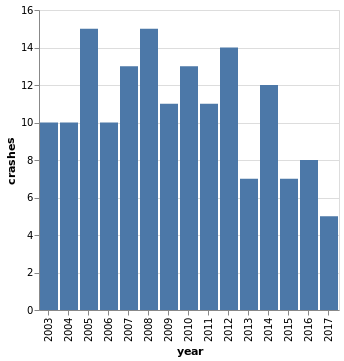

In [3]:
df = pd.DataFrame({
    'crashes': [10, 10, 15, 10, 13, 15, 11, 13, 11, 14, 7, 12, 7, 8, 5],
    'year': list(range(2003, 2018))
})
alt.Chart(df).mark_bar().encode(x='year:O', y='crashes')

## Bayesian Markov-Chain Monte-Carlo methods.

PyMC3 works by constructing a statistical model for generating your data.
It then fits the model by means of Bayesian Markov-Chain Monte-Carlo (MCMC) analysis.
A full explication of MCMC methods is well beyond the scope of this article,
but here is a brief qualitative description of how they work:
A Markov-Chain method describes a process that moves through parameter space,
where the transition to each state depends only on the previous state.
A Monte-Carlo method is a general term for a computational method
where there are many random draws of values in performing the computation
(for a fun example of this, see [Buffon's needle](https://en.wikipedia.org/wiki/Buffon%27s_needle_problem)).

Bayesian MCMC methods typically involve constructing a statistical model with some unknown parameter values.
An MCMC algorithm then explores the space of these possible parameter values,
testing how well each point in parameter space fits the observed data.
They do this by hopping generally towards points of higher probability
(roughly the Markov-chain part), with an element of randomness (roughly the Monte-Carlo part)
so they don't get caught in local maxima.

As a result of this approach, Bayesian MCMC methods furnish not only an estimate of the best parameter values,
but also an estimate of the uncertainties and tradeoffs.
This estimate of the uncertainty is particularly useful to us in looking at the Rowena road diet.
We are not just interested in how much the rate of crashes has decreased, but how much we can trust that number.

## A model for crashes

We will model the rate of crashes along Rowena as a Poisson process.
Poisson processes describe counting statistics which are memory-less.
Events described by a such a process have fixed probability of occurring at any given time,
and these events are statistically independent of each other.
Poisson processes are routinely used to model earthquakes, pedestrian counts,
website traffic, and, indeed, car crashes.

Now, the features of constant-rates and memorylessness are probably not completely accurate.
Over the last few years, rates of car crashes, especially those involving pedestrians,
have been on a persistent increase. And over time periods of seconds,
car crashes are certainly not statistically unrelated (crashes beget more crashes).
However, we will assume that bunched crashes on a second-time-scale are considered a single event,
and that local effects on Rowena are more important than longer-term city-wide secular changes,
and therefore move forward with a Poisson process.

We will consider a model where there is an early rate of collisions,
a later rate of collisions, and a time point at which the rate changes from early to late.
This makes for a three parameter model (early rate, late rate, and change point).

Bayesian methods require us to define prior distributions for each of the parameters for which we are fitting.
These represent our prior beliefs about the values of the parameters.
Sometimes the need to choose a prior is a cause of some angst for the practitioner,
but I would argue that they provide much of the power and expressiveness of Bayesian methods.
They allow us to build in our understanding of the physics of the model,
and are a natural way to regularize the model, providing a powerful tool against overfitting.

We will make the following choices for the priors of our three parameters:

* For the change point we will assign a uniform prior from 2003 to 2017, indicating that we consider
any point from 2003 to 2017 to be equally likely to contain a change.
* For the rate parameters we will choose exponential distributions.
These are useful for representing strictly positive real number values (as the rate must be),
where very high numbers are less likely than very low number.
Exponential distributions are specified via a scale parameter $\lambda$
(a so-called "hyperparameter" for our model),
which characterizes how quickly the probability density decays.
The mean of an exponential distribution is equal to $1/\lambda$,
so we will use the overall mean of the number of crashes per year on Rowena
to choose the $\lambda$ for our priors on both the early and late rates.

## Constructing the model with PyMC3

PyMC3 provides a nice API for constructing statistical models out of our chosen distributions,
including ways of specifying random variables with our chosen prior distributions.
We begin by declaring our rate variables, with $\lambda$ equal to one over the overall mean of the crash rate:

In [4]:
with pymc3.Model() as road_diet_model:   
    early_rate = pymc3.Exponential('early_rate', 1./df.crashes.mean())
    late_rate = pymc3.Exponential('late_rate', 1./df.crashes.mean())

Next, we declare the switch point variable with a discrete uniform prior between the years of our dataset:

In [5]:
with road_diet_model:
    switchpoint = pymc3.DiscreteUniform(
        'switchpoint',
        lower=df.year.min(),
        upper=df.year.max()
    )

We need to stitch together these random variables with a meta-random variable for the overall rate,
which switches from `early_rate` to `late_rate` after `switchpoint`,
which can be accomplished using the pymc utility function `switch`:

In [6]:
with road_diet_model:
    rate = pymc3.math.switch(switchpoint >= df.year, early_rate, late_rate)

Finally, we need to inform the model of the observed data, which we presume
have been generated using a Poisson process:

In [7]:
with road_diet_model:
    crashes = pymc3.Poisson('crashes', rate, observed=df.crashes)    

This completes the specification of the statistical model of crashes on Rowena.
All that remains is to conduct the MCMC sampling:

In [8]:
with road_diet_model:
    trace = pymc3.sample(10000)

Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>NUTS: [late_rate, early_rate]
>Metropolis: [switchpoint]
Sampling 4 chains: 100%|██████████| 42000/42000 [01:26<00:00, 487.02draws/s]
There were 204 divergences after tuning. Increase `target_accept` or reparameterize.
There were 44 divergences after tuning. Increase `target_accept` or reparameterize.
There were 542 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.6085023527412249, but should be close to 0.8. Try to increase the number of tuning steps.
There were 79 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 10% for some parameters.


The resulting samples from the MCMC algorithm are stored in the `trace` object.
We can put those samples in a dataframe for further analysis:

In [9]:
trace_df = pd.DataFrame({
    'switchpoint': trace['switchpoint'],
    'early_rate': trace['early_rate'],
    'late_rate': trace['late_rate']
})

## Analyzing the results

The resulting samples from the MCMC trace are representative of the posterior distribution for our model.
Descriptive statistics and plots can therefore give us insight into our beliefs about the random variables.

The following histogram of our rate samples shows whether we should consider the rate to have changed:

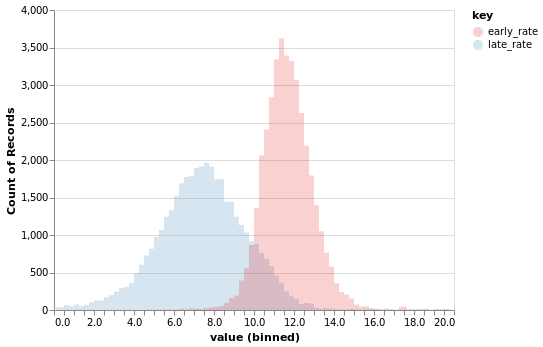

In [22]:
alt.Chart(trace_df[(trace_df.late_rate < 20) & (trace_df.early_rate < 20)]).transform_fold(
    ['late_rate', 'early_rate']
).mark_area(
    opacity=0.2, interpolate='step', clip=True
).encode(
    alt.X('value:Q', bin=alt.Bin(step=0.25)),
    alt.Y('count()', stack=None),
    color=alt.Color('key:N', scale=alt.Scale(scheme='set1'))
)

As described in the LADOT report, the later rate of crashes appears to be less than the early rate.
However, there is significant uncertainty in the value of each of them, and there is some overlap.

We are also interested in the posterior distribution for the change point:

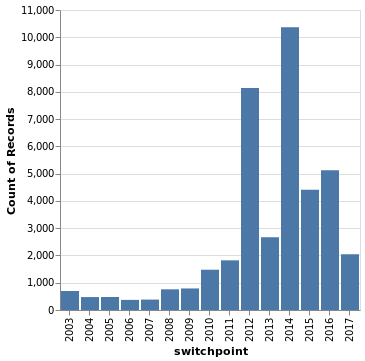

In [25]:
alt.Chart(trace_df).mark_bar().encode(alt.X('switchpoint:O'), y='count()')

There is considerable uncertainty in when the posterior distribution for the switchpoint,
though the great majority of the probability density is in the latter portion of the time interval.
The most likely year for the rates to have switched is 2014, the year after the road diet was enacted.

We are most interested in the topline number from the LADOT report:
by how much has the rate of crashes changed?
And what is the uncertainty in that number?

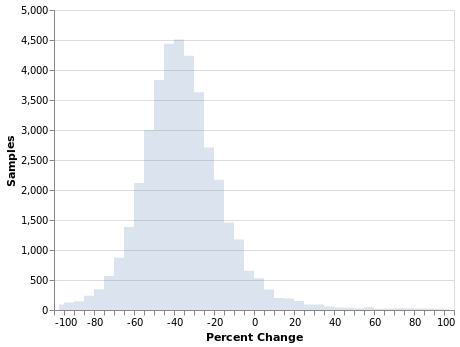

In [32]:
trace_df['rate_diff'] = trace_df.early_rate-trace_df.late_rate
trace_df['change'] = (-trace_df.rate_diff/trace_df.early_rate)*100

alt.Chart(trace_df[trace_df.change < 100]).mark_area(
    opacity=0.2, interpolate='step', clip=True
).encode(
    alt.X('change:Q', title="Percent Change", bin=alt.Bin(step=5)),
    alt.Y('count()', title="Samples"),
)

The change in the rate of crashes is 

In [29]:
pymc3.stats.hpd(trace_df.change)

array([-81.04661391,   9.49668771])

In [30]:
trace_df.change.mean()

-33.64009604298878

In [31]:
sum(trace_df.rate_diff > 0)/len(trace_df)

0.94225